# Detect Using Transfer Learning

# Imports

In [57]:
import numpy as np
import os
import six.moves.urllib as urllib
import sys
import tarfile

os.environ["CUDA_VISIBLE_DEVICES"]="-1"  
import tensorflow as tf
import zipfile

from distutils.version import StrictVersion
from collections import defaultdict
from io import StringIO
from matplotlib import pyplot as plt
from PIL import Image

# This is needed since the notebook is stored in the object_detection folder.
sys.path.append("..")
from object_detection.utils import ops as utils_ops
print(StrictVersion(tf.__version__))
if StrictVersion(tf.__version__) < StrictVersion('1.9.0'):
  raise ImportError('Please upgrade your TensorFlow installation to v1.9.* or later!')


1.12


In [2]:
from tensorflow.python.client import device_lib
print(device_lib.list_local_devices())
#sess = tf.Session(config=tf.ConfigProto(log_device_placement=True))
#sess = tf.Session(config=tf.ConfigProto(device_count={'GPU': 0}))


[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 9046275642477285474
]


## Env setup

In [3]:
# This is needed to display the images.
%matplotlib inline

## Object detection imports
Here are the imports from the object detection module.

In [4]:
from utils import label_map_util
from utils import visualization_utils as vis_util

C:\Users\junli\Documents\Research\levorato\tf_tutorials\models\research\object_detection\utils\visualization_utils.py:27: UserWarning: 
This call to matplotlib.use() has no effect because the backend has already
been chosen; matplotlib.use() must be called *before* pylab, matplotlib.pyplot,
or matplotlib.backends is imported for the first time.

The backend was *originally* set to 'module://ipykernel.pylab.backend_inline' by the following code:
  File "C:\Users\junli\AppData\Local\Continuum\anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\Users\junli\AppData\Local\Continuum\anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\junli\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\junli\AppData\Local\Continuum\anaconda3\lib\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.st

# Data preparation

# Model preparation 

## Variables

Any model exported using the `export_inference_graph.py` tool can be loaded here simply by changing `PATH_TO_FROZEN_GRAPH` to point to a new .pb file.  

By default we use an "SSD with Mobilenet" model here. See the [detection model zoo](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/detection_model_zoo.md) for a list of other models that can be run out-of-the-box with varying speeds and accuracies.

In [9]:
# # What model to download.
MODEL_NAME = 'faster_rcnn_inception_v2_coco_2018_01_28'
# MODEL_FILE = MODEL_NAME + '.tar.gz'
# DOWNLOAD_BASE = 'http://download.tensorflow.org/models/object_detection/'

# # Path to frozen detection graph. This is the actual model that is used for the object detection.
# PATH_TO_FROZEN_GRAPH = "inference_graph/" + MODEL_NAME + '/frozen_inference_graph.pb'

# # List of the strings that is used to add correct label for each box.
PATH_TO_LABELS = os.path.join('data', 'mscoco_label_map.pbtxt')

## Download Model

In [8]:
# opener = urllib.request.URLopener()
# opener.retrieve(DOWNLOAD_BASE + MODEL_FILE, MODEL_FILE)
# tar_file = tarfile.open(MODEL_FILE)
# for file in tar_file.getmembers():
#   file_name = os.path.basename(file.name)
#   if 'frozen_inference_graph.pb' in file_name:
#     tar_file.extract(file, os.getcwd())

## Load a (frozen) Tensorflow model into memory.

In [8]:
PATH_TO_FROZEN_GRAPH = "inference_graph/" + MODEL_NAME + '/frozen_inference_graph.pb'
detection_graph = tf.Graph()
with detection_graph.as_default():
  od_graph_def = tf.GraphDef()
  with tf.gfile.GFile(PATH_TO_FROZEN_GRAPH, 'rb') as fid:
    serialized_graph = fid.read()
    od_graph_def.ParseFromString(serialized_graph)
    tf.import_graph_def(od_graph_def, name='')

## Loading label map
Label maps map indices to category names, so that when our convolution network predicts `5`, we know that this corresponds to `airplane`.  Here we use internal utility functions, but anything that returns a dictionary mapping integers to appropriate string labels would be fine

In [10]:
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS, use_display_name=True)

## Helper code

In [11]:
def load_image_into_numpy_array(image):
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)

# Detection

In [59]:
# For the sake of simplicity we will use only 2 images:
# image1.jpg
# image2.jpg
# If you want to test the code with your images, just add path to the images to the TEST_IMAGE_PATHS.
PATH_TO_TEST_IMAGES_DIR = 'test_images'
PATH_TO_DRONE_IMAGES="drone_images/training"
TEST_IMAGE_PATHS = [ os.path.join(PATH_TO_DRONE_IMAGES, 'frame{}.jpg'.format(i)) for i in [6610,8384,12618,14026,16345]]
TEST_IMAGE_PATHS.append(os.path.join(PATH_TO_DRONE_IMAGES,'image1.jpg'))
# Size, in inches, of the output images.
IMAGE_SIZE = (12, 8)

In [49]:
def run_inference_for_single_image(image, graph):
  with graph.as_default():
    with tf.Session() as sess:
      # Get handles to input and output tensors
      ops = tf.get_default_graph().get_operations()
      writer = tf.summary.FileWriter('./graph_logs/drones', sess.graph)
      all_tensor_names = {output.name for op in ops for output in op.outputs}
      tensor_dict = {}
      for key in [
          'num_detections', 'detection_boxes', 'detection_scores',
          'detection_classes', 'detection_masks'
      ]:
        tensor_name = key + ':0'
        if tensor_name in all_tensor_names:
          tensor_dict[key] = tf.get_default_graph().get_tensor_by_name(
              tensor_name)
      if 'detection_masks' in tensor_dict:
        # The following processing is only for single image
        detection_boxes = tf.squeeze(tensor_dict['detection_boxes'], [0])
        detection_masks = tf.squeeze(tensor_dict['detection_masks'], [0])
        # Reframe is required to translate mask from box coordinates to image coordinates and fit the image size.
        real_num_detection = tf.cast(tensor_dict['num_detections'][0], tf.int32)
        detection_boxes = tf.slice(detection_boxes, [0, 0], [real_num_detection, -1])
        detection_masks = tf.slice(detection_masks, [0, 0, 0], [real_num_detection, -1, -1])
        detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
            detection_masks, detection_boxes, image.shape[0], image.shape[1])
        detection_masks_reframed = tf.cast(
            tf.greater(detection_masks_reframed, 0.5), tf.uint8)
        # Follow the convention by adding back the batch dimension
        tensor_dict['detection_masks'] = tf.expand_dims(
            detection_masks_reframed, 0)
      image_tensor = tf.get_default_graph().get_tensor_by_name('image_tensor:0')

      # Run inference
      output_dict = sess.run(tensor_dict,
                             feed_dict={image_tensor: np.expand_dims(image, 0)})

      # all outputs are float32 numpy arrays, so convert types as appropriate
      output_dict['num_detections'] = int(output_dict['num_detections'][0])
      output_dict['detection_classes'] = output_dict[
          'detection_classes'][0].astype(np.uint8)
      output_dict['detection_boxes'] = output_dict['detection_boxes'][0]
      output_dict['detection_scores'] = output_dict['detection_scores'][0]
      if 'detection_masks' in output_dict:
        output_dict['detection_masks'] = output_dict['detection_masks'][0]
  return output_dict

1280 720
frame10019.xml
1280 720
frame10892.xml
1280 720
frame12780.xml
1280 720
frame12988.xml
1280 720
frame13003.xml
1280 720
frame13539.xml
1280 720
frame14225.xml
1280 720
frame14234.xml
1280 720
frame14492.xml
1280 720
frame14924.xml
1280 720
frame15035.xml
1280 720
frame15244.xml
1280 720
frame15381.xml
1280 720
frame15531.xml
1280 720
frame15732.xml
1280 720
frame15907.xml
1280 720
frame16043.xml
1280 720
frame16258.xml
1280 720
frame16278.xml
1280 720
frame16291.xml
1280 720
frame16338.xml


C:\Users\junli\AppData\Local\Continuum\anaconda3\lib\site-packages\matplotlib\pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


1280 720
frame16365.xml
1280 720
frame16396.xml
1280 720
frame16427.xml
1280 720
frame16491.xml
1280 720
frame16539.xml
1280 720
frame16556.xml
1280 720
frame16563.xml
1280 720
frame16787.xml
1280 720
frame16811.xml
1280 720
frame16843.xml
1280 720
frame16931.xml
1280 720
frame16971.xml
1280 720
frame17035.xml
1280 720
frame17507.xml
1280 720
frame234.xml
1280 720
frame2378.xml
1280 720
frame267.xml
1280 720
frame2707.xml
1280 720
frame2708.xml
1280 720
frame2876.xml
1280 720
frame299.xml
1280 720
frame3108.xml
1280 720
frame339.xml
1280 720
frame3467.xml
1280 720
frame3508.xml
1280 720
frame3555.xml
1280 720
frame371.xml
1280 720
frame385.xml
1280 720
frame412.xml
1280 720
frame429.xml
1280 720
frame516.xml
1280 720
frame564.xml
1280 720
frame572.xml
1280 720
frame684.xml
1280 720
frame8035.xml
1280 720
frame8043.xml
1280 720
frame811.xml
1280 720
frame8210.xml
1280 720
frame8243.xml
1280 720
frame8315.xml
1280 720
frame8370.xml
1280 720
frame8426.xml
1280 720
frame8531.xml
1280 720
f

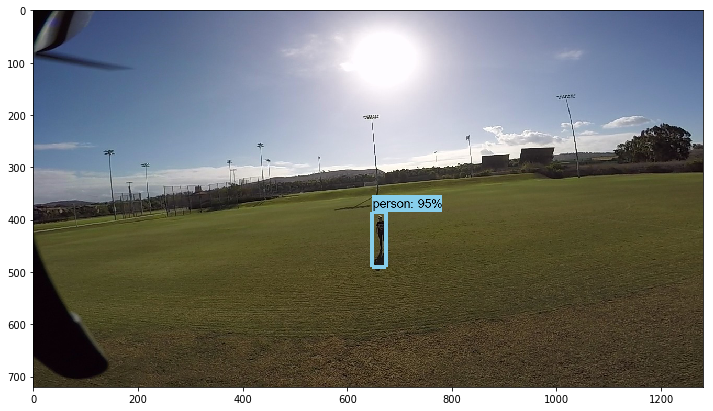

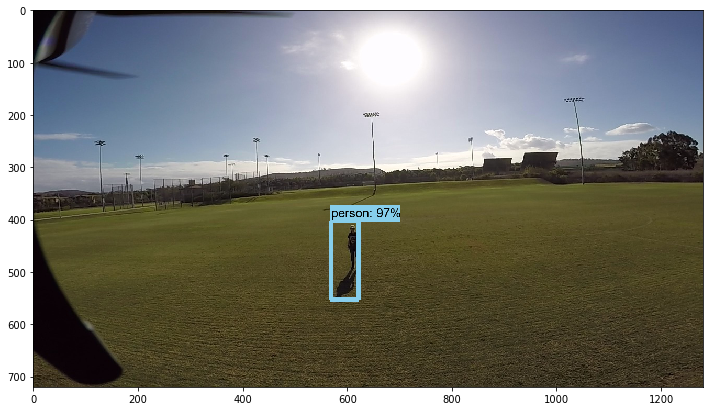

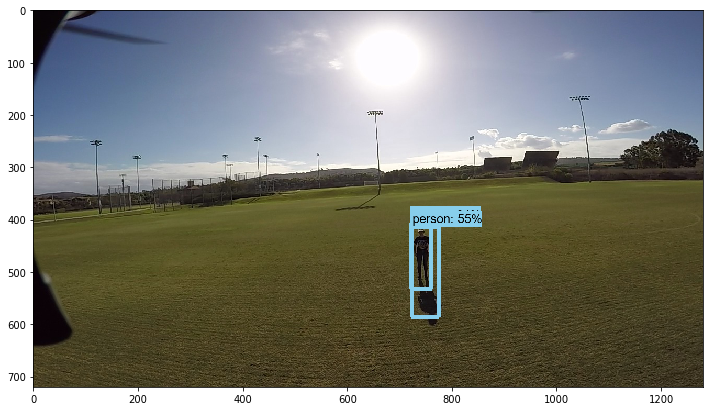

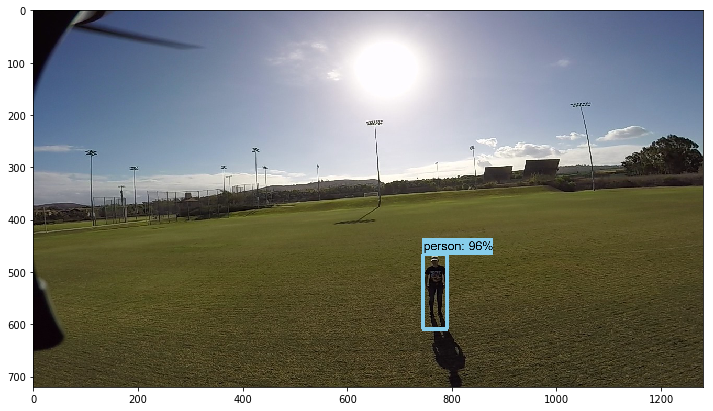

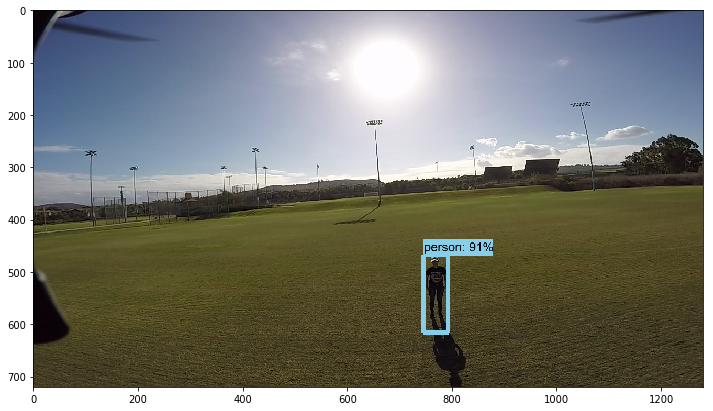

...

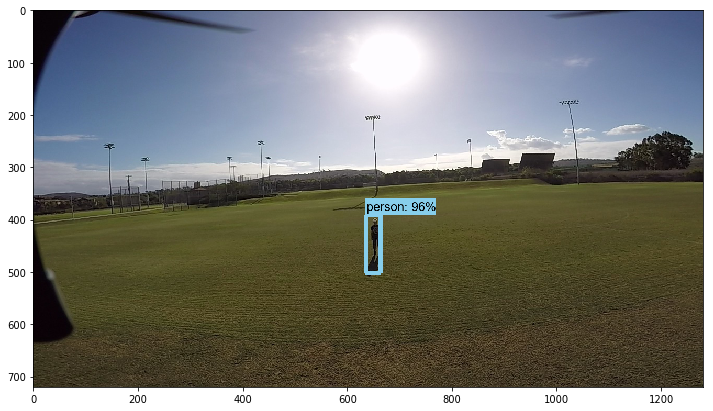

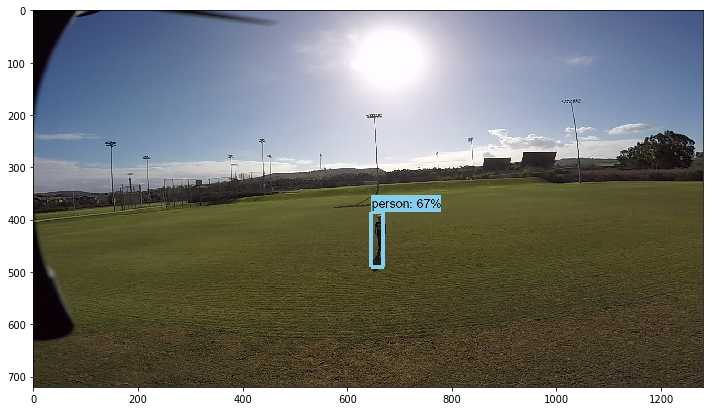

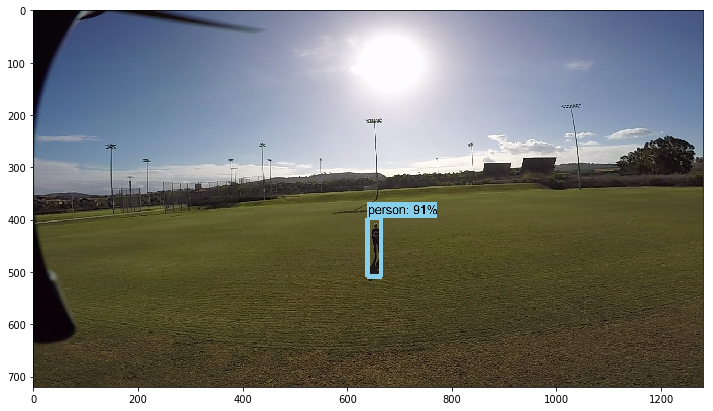

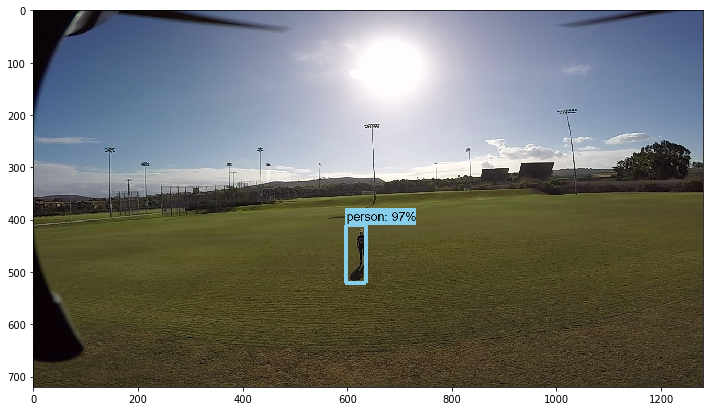

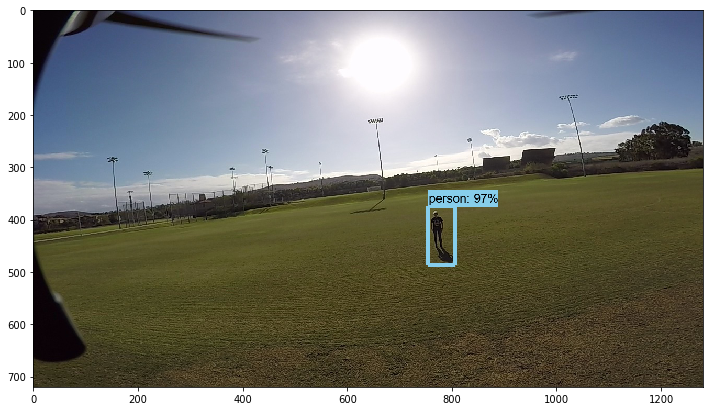

In [60]:
import xml.etree.cElementTree as ET
import ntpath
import glob
for image_path in glob.glob(PATH_TO_DRONE_IMAGES + "/*.JPG"):
    image = Image.open(image_path)
    # the array based representation of the image will be used later in order to prepare the
    # result image with boxes and labels on it.
    image_np = load_image_into_numpy_array(image)
    height,width,depth = image_np.shape
    print(width,height)
    # Expand dimensions since the model expects images to have shape: [1, None, None, 3]
    image_np_expanded = np.expand_dims(image_np, axis=0)
    # Actual detection.
    output_dict = run_inference_for_single_image(image_np, detection_graph)
    # Visualization of the results of a detection.
    #print(output_dict['detection_boxes'])
    n = output_dict["num_detections"]
    image_name = ntpath.basename(image_path)
    image_name, _ = os.path.splitext(image_name)
    root = ET.Element("annotation")
    ET.SubElement(root, "filename").text = image_name+_
    doc = ET.SubElement(root, "size")
    ET.SubElement(doc, "width").text = str(width)
    ET.SubElement(doc, "height").text = str(height)
    ET.SubElement(doc, "depth").text = "3"
    
    for i in range(n):
        if output_dict["detection_scores"][i] > 0.5:

            name = category_index[output_dict["detection_classes"][i]]["name"]
            if name != "person":
                continue
            obj = ET.SubElement(root, "object")            
            ET.SubElement(obj, "name").text = category_index[output_dict["detection_classes"][i]]["name"]
            ET.SubElement(obj, "pose").text = "Unspecified"
            ET.SubElement(obj, "truncated").text = 0
            ET.SubElement(obj, "difficult").text = 0
            bndbox = ET.SubElement(obj, "bndbox")
            #print(output_dict["detection_boxes"][i][0])
            ET.SubElement(bndbox, "xmin").text = str(int(output_dict["detection_boxes"][i][1] * width) )
            ET.SubElement(bndbox, "ymin").text = str(int(output_dict["detection_boxes"][i][0] * height))
            ET.SubElement(bndbox, "xmax").text = str(int(output_dict["detection_boxes"][i][3] * width))
            ET.SubElement(bndbox, "ymax").text = str(int(output_dict["detection_boxes"][i][2] * height))

    tree = ET.ElementTree(root)
    path_to_write = os.path.join(PATH_TO_DRONE_IMAGES,"{}.xml".format(image_name))
    filename = image_name+".xml"
    print(filename)
    tree.write(PATH_TO_DRONE_IMAGES + '/' + filename)

    vis_util.visualize_boxes_and_labels_on_image_array(
      image_np,
      output_dict['detection_boxes'],
      output_dict['detection_classes'],
      output_dict['detection_scores'],
      category_index,
      instance_masks=output_dict.get('detection_masks'),
      use_normalized_coordinates=True,
      line_thickness=8)
    plt.figure(figsize=IMAGE_SIZE)
    plt.imshow(image_np)

In [16]:
category_index[1]

{'id': 1, 'name': 'person'}